In [1]:
# !pip install arcface

In [2]:
# !pip install retina-face


In [3]:
# !pip install pyheif pillow

In [4]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from retinaface import RetinaFace  # Ensure RetinaFace is installed
from arcface import ArcFace
import os
from PIL import Image
import pillow_heif
import os
import pyheif
from PIL import Image
import math
# from gfpgan import GFPGANer


2025-06-27 01:37:50.022978: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-06-27 01:37:50.029966: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-06-27 01:37:50.087020: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-06-27 01:37:50.133922: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:467] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1750968470.178326    4335 cuda_dnn.cc:8579] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1750968470.19

In [5]:


# # Specify the path to your zip file
# zip_file_path = '/content/DL Project Data-20250129T125528Z-001.zip'
# extract_folder = '/content/'

# # Unzip the file
# with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
#     zip_ref.extractall(extract_folder)

# print(f"Unzipped the file to {extract_folder}")


In [6]:
# import tensorflow as tf

# # Load the .h5 model
# keras_model = tf.keras.models.load_model("/content/ArcFace-Res50.h5")

# # Convert to TFLite format
# converter = tf.lite.TFLiteConverter.from_keras_model(keras_model)
# tflite_model = converter.convert()

# # Save the converted model
# tflite_model_path = "/content/ArcFace-Res50.tflite"
# with open(tflite_model_path, "wb") as f:
#     f.write(tflite_model)

# print(f"Model converted and saved at: {tflite_model_path}")

In [7]:
# Initialize ArcFace model
face_rec = ArcFace.ArcFace(model_path="ArcFace-Res50.tflite")

# Lists to store faces and embeddings
all_faces = []
embeddings = []



INFO: Created TensorFlow Lite XNNPACK delegate for CPU.


In [8]:
# Define source directory
source_dir = "DL Project Data/28-01-2025"

# Traverse directory and find .heic files
for root, _, files in os.walk(source_dir):
    for file in files:
        if file.lower().endswith(".heic"):
            heic_path = os.path.join(root, file)
            jpg_path = os.path.splitext(heic_path)[0] + ".jpg"

            # Convert HEIC to JPG
            heif_file = pyheif.read(heic_path)
            image = Image.frombytes(
                heif_file.mode,
                heif_file.size,
                heif_file.data,
                "raw",
                heif_file.mode
            )

            # Save as JPG
            image.save(jpg_path, "JPEG")
            print(f"Converted: {heic_path} → {jpg_path}")

Converted: DL Project Data/28-01-2025/IMG_7330.HEIC → DL Project Data/28-01-2025/IMG_7330.jpg
Converted: DL Project Data/28-01-2025/IMG_7331.HEIC → DL Project Data/28-01-2025/IMG_7331.jpg
Converted: DL Project Data/28-01-2025/IMG_7328.HEIC → DL Project Data/28-01-2025/IMG_7328.jpg
Converted: DL Project Data/28-01-2025/IMG_7329.HEIC → DL Project Data/28-01-2025/IMG_7329.jpg
Converted: DL Project Data/28-01-2025/IMG_7325.HEIC → DL Project Data/28-01-2025/IMG_7325.jpg
Converted: DL Project Data/28-01-2025/IMG_7326.HEIC → DL Project Data/28-01-2025/IMG_7326.jpg
Converted: DL Project Data/28-01-2025/IMG_7327.HEIC → DL Project Data/28-01-2025/IMG_7327.jpg


In [9]:
image_files = []
for root, _, files in os.walk('DL Project Data/07-01-2025'):
    for file in files:
      if file.lower().endswith(".jpg") or file.lower().endswith(".jpeg") or file.lower().endswith(".png"):
        image_files.append(os.path.join(root, file))

print(image_files)


['DL Project Data/07-01-2025/20250107_180050.jpg', 'DL Project Data/07-01-2025/20250107_175922.jpg', 'DL Project Data/07-01-2025/20250107_175858.jpg', 'DL Project Data/07-01-2025/20250107_175945.jpg', 'DL Project Data/07-01-2025/20250107_175938.jpg', 'DL Project Data/07-01-2025/20250107_175908.jpg', 'DL Project Data/07-01-2025/20250107_175926.jpg', 'DL Project Data/07-01-2025/20250107_180023.jpg']


E0000 00:00:1750968473.266447    4335 cuda_executor.cc:1228] INTERNAL: CUDA Runtime error: Failed call to cudaGetRuntimeVersion: Error loading CUDA libraries. GPU will not be used.: Error loading CUDA libraries. GPU will not be used.
W0000 00:00:1750968473.267752    4335 gpu_device.cc:2341] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


Image: DL Project Data/07-01-2025/20250107_180050.jpg | Faces detected: 65


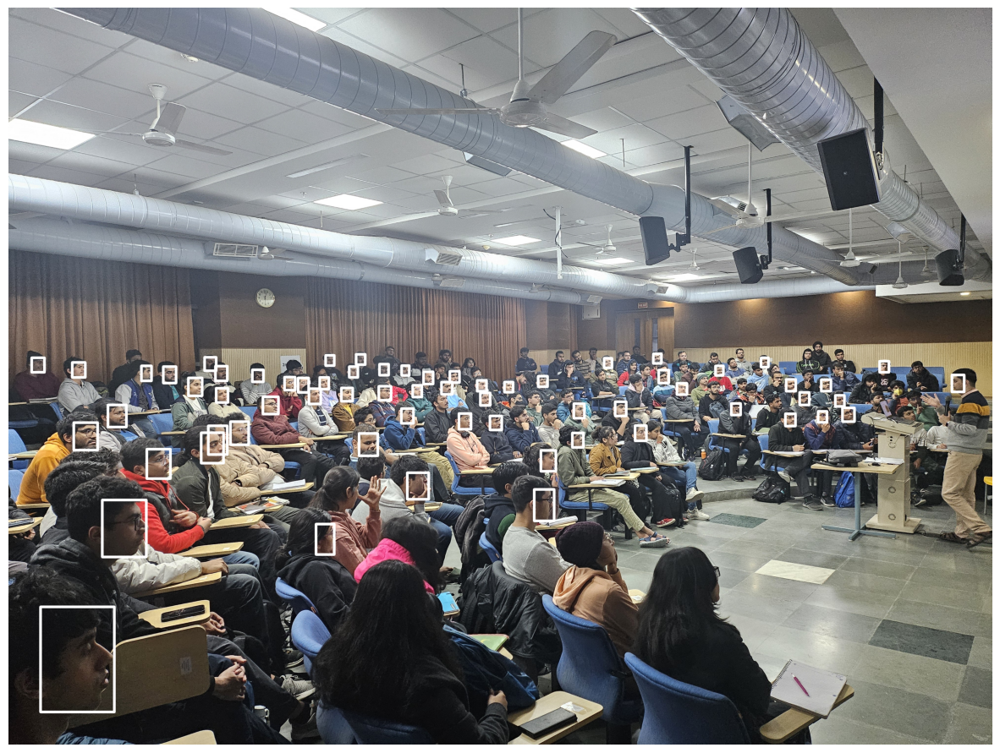

Image: DL Project Data/07-01-2025/20250107_175922.jpg | Faces detected: 68


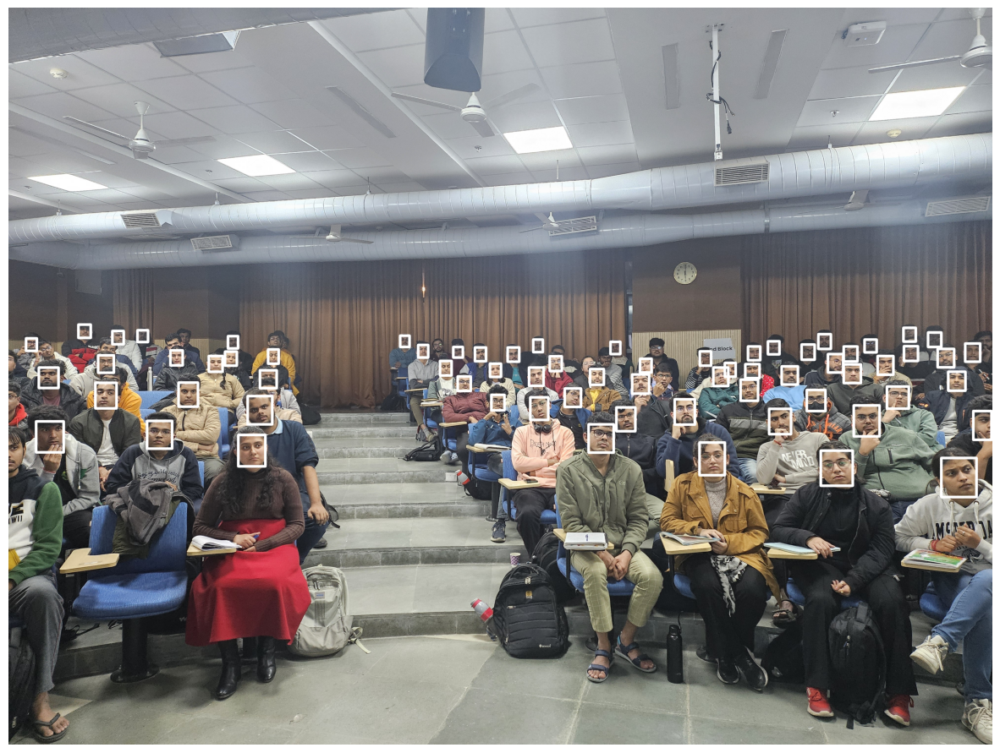

Image: DL Project Data/07-01-2025/20250107_175858.jpg | Faces detected: 107


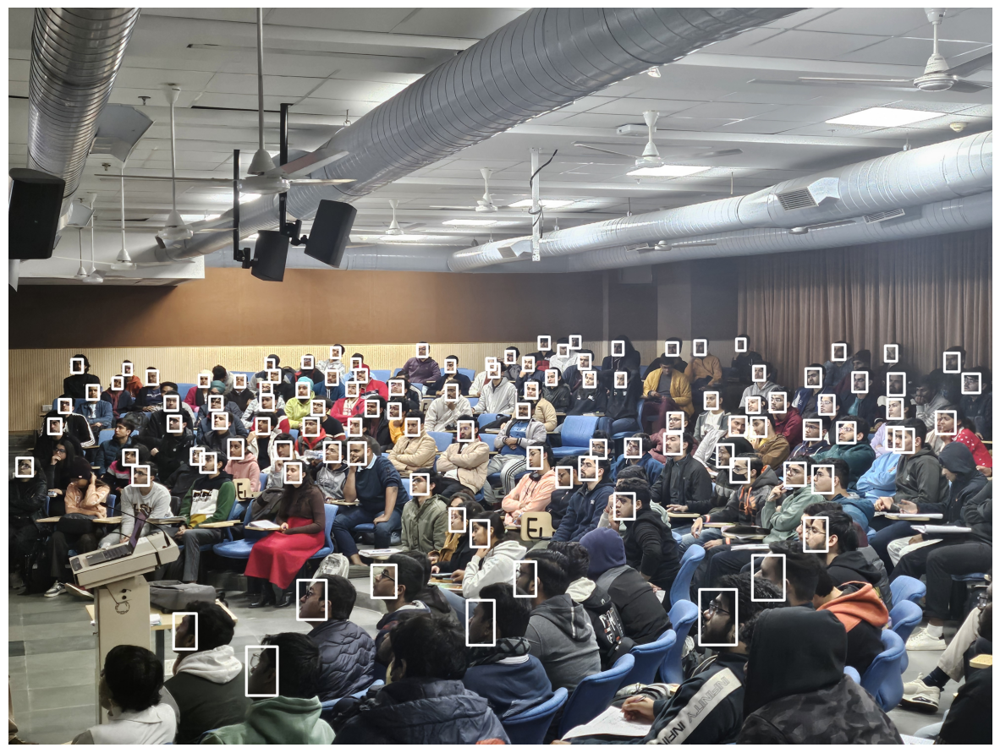

Image: DL Project Data/07-01-2025/20250107_175945.jpg | Faces detected: 83


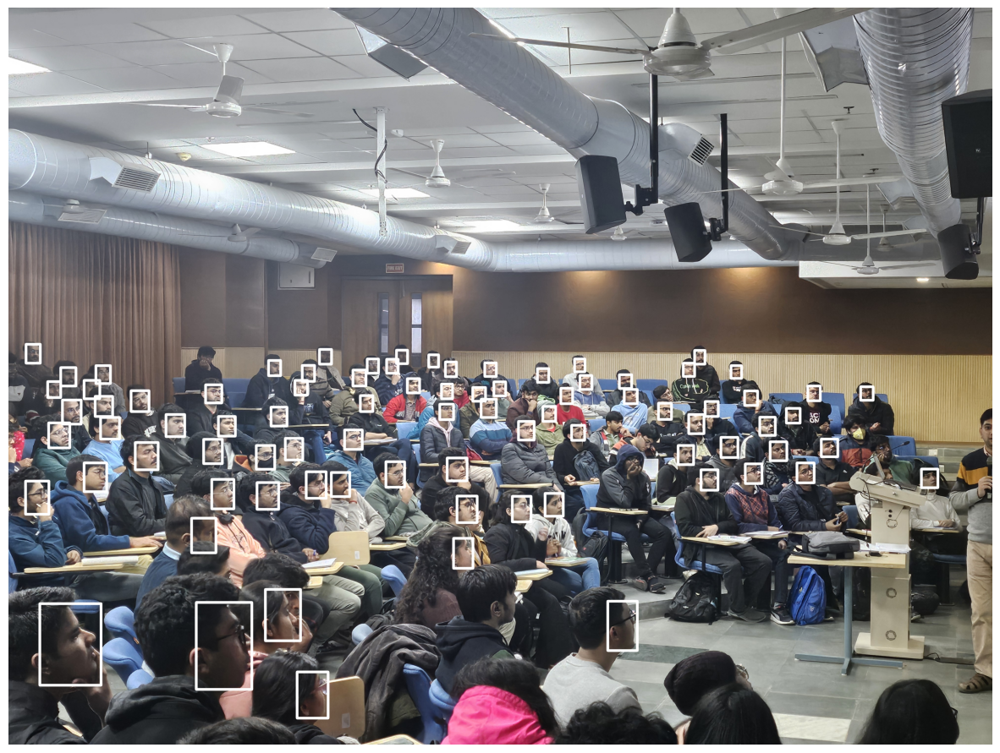

Image: DL Project Data/07-01-2025/20250107_175938.jpg | Faces detected: 71


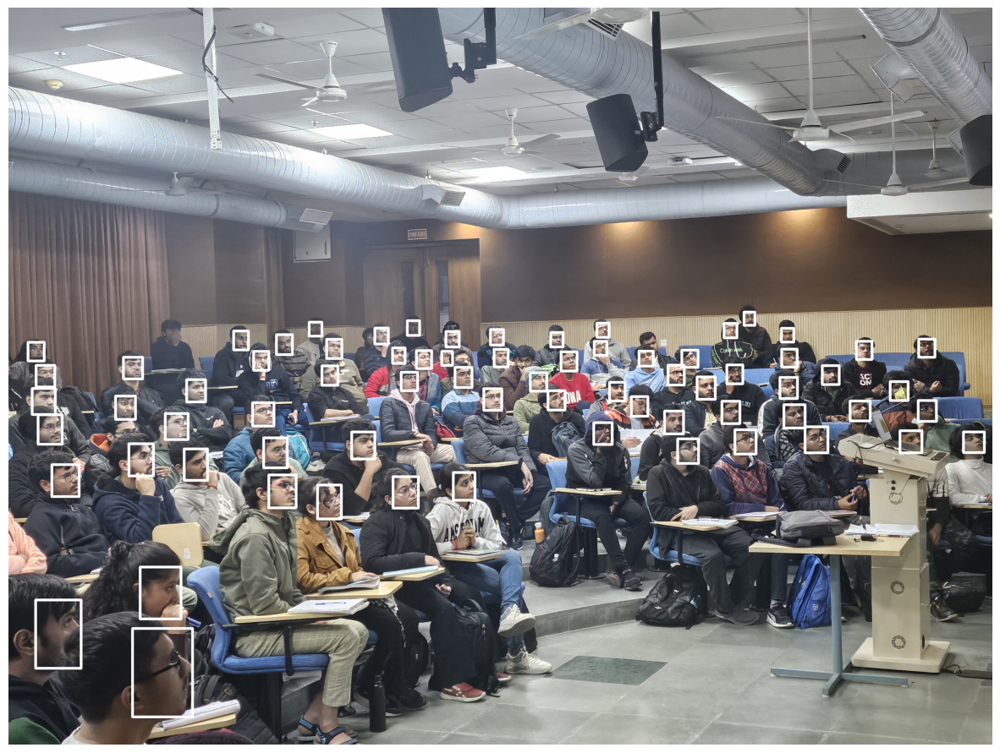

Image: DL Project Data/07-01-2025/20250107_175908.jpg | Faces detected: 68


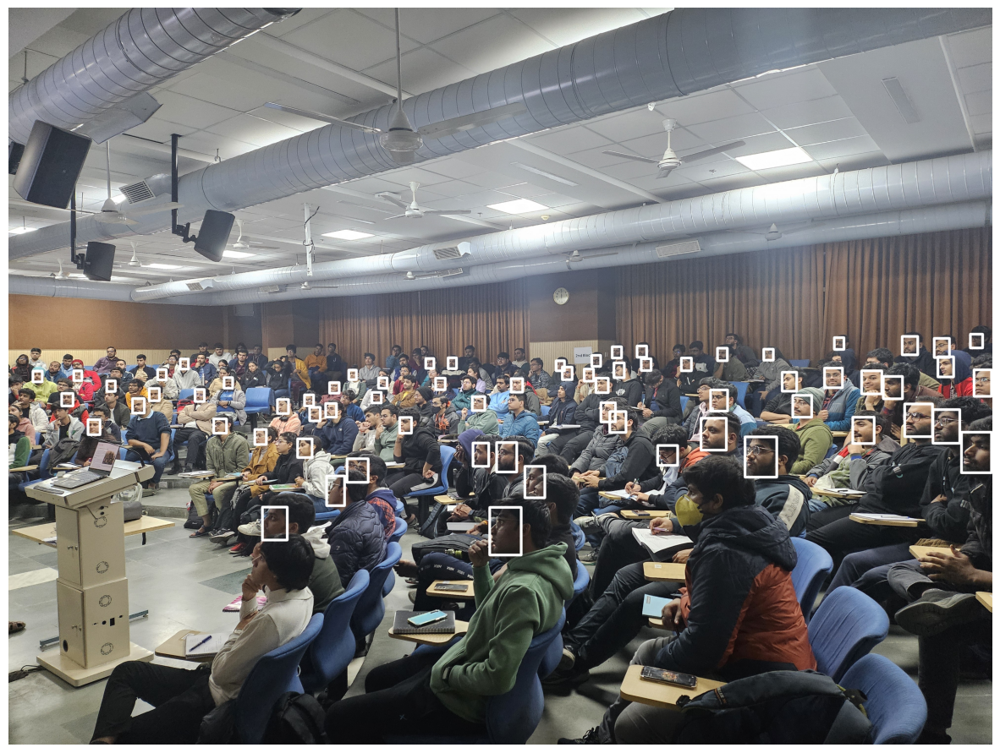

Image: DL Project Data/07-01-2025/20250107_175926.jpg | Faces detected: 71


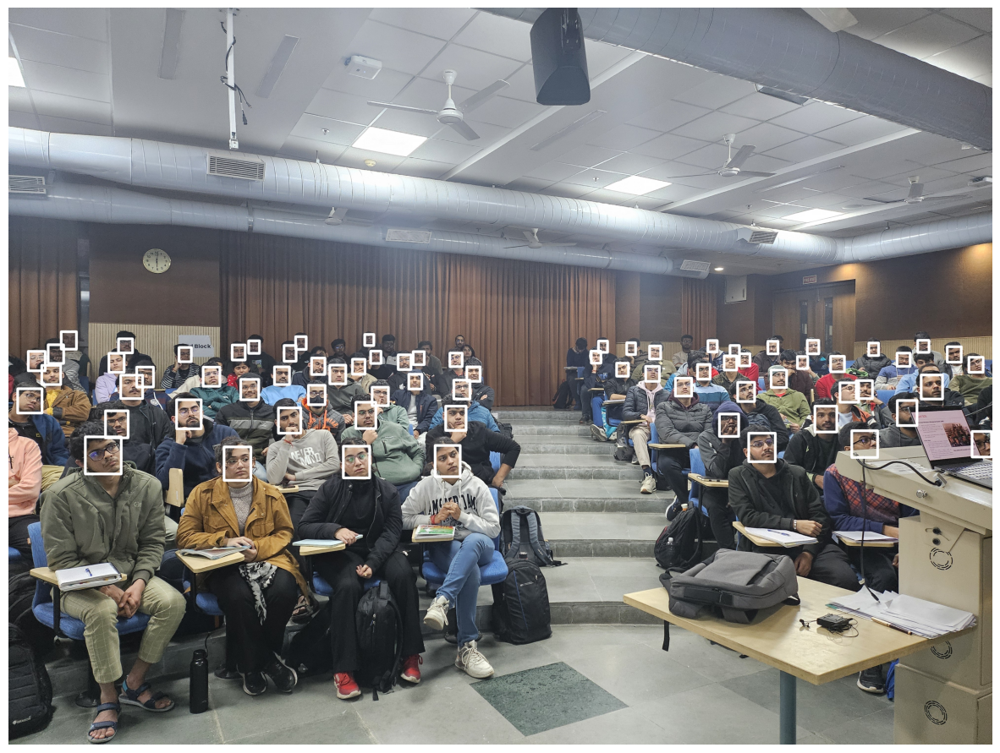

Image: DL Project Data/07-01-2025/20250107_180023.jpg | Faces detected: 61


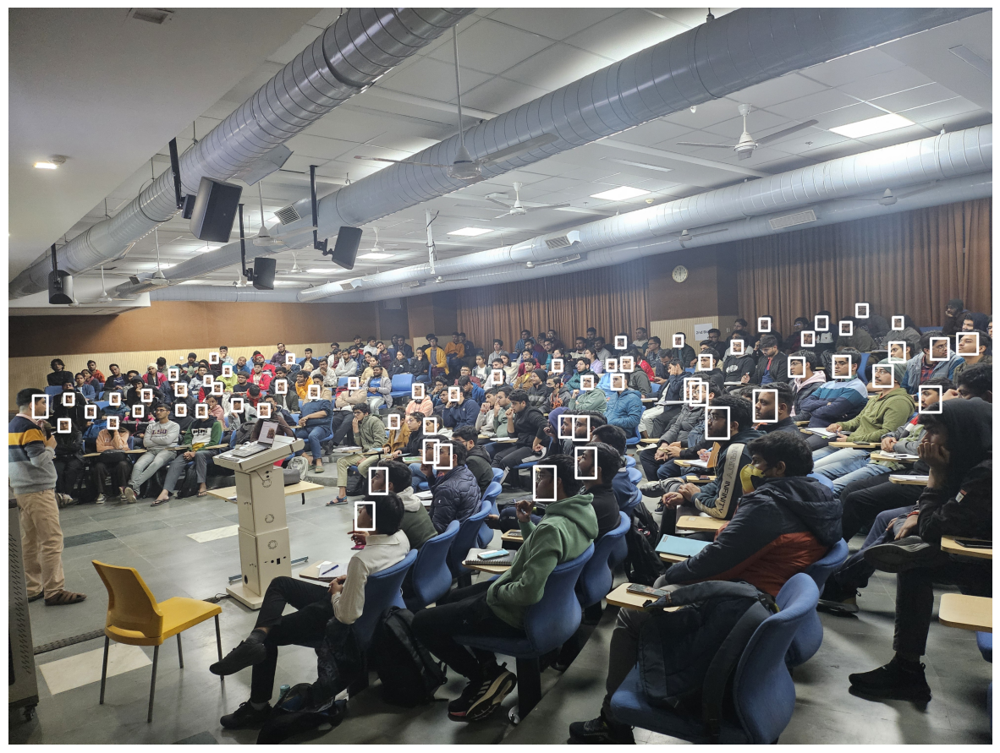

In [10]:
# Folder to store extracted faces
output_folder = "face_images"
os.makedirs(output_folder, exist_ok=True)

all_faces = []  # Store extracted faces if needed

for img_path in image_files:
    img = cv2.imread(img_path)
    if img is None:
        continue

    # Create a copy of the original image for visualization
    img_with_rectangles = img.copy()

    # Detect faces
    faces = RetinaFace.detect_faces(img)
    print(f'Image: {img_path} | Faces detected: {len(faces)}')

    for key in faces.keys():
        identity = faces[key]
        facial_area = identity["facial_area"]
        x1, y1, x2, y2 = facial_area

        # Ensure valid coordinates
        x1, y1 = max(0, x1), max(0, y1)
        x2, y2 = min(img.shape[1], x2), min(img.shape[0], y2)
        if x1 >= x2 or y1 >= y2:
            continue

        # ----------------------------
        # FIRST: Extract face from ORIGINAL image (no border)
        # ----------------------------
        face_img = img[y1:y2, x1:x2]  # Use original image for extraction
        if face_img.size == 0:
            continue

        # Save the extracted face (no border)
        face_filename = os.path.join(output_folder, f"face_{key}_{os.path.basename(img_path)}")
        cv2.imwrite(face_filename, face_img)

        # Convert to RGB for storage if needed
        face_rgb = cv2.cvtColor(face_img, cv2.COLOR_BGR2RGB)
        all_faces.append(face_rgb)

        # ----------------------------
        # THEN: Draw rectangle on COPY
        # ----------------------------
        cv2.rectangle(img_with_rectangles, (x1, y1), (x2, y2), (255, 255, 255), 10)

    # Display the image with rectangles
    plt.figure(figsize=[15, 15])
    plt.imshow(cv2.cvtColor(img_with_rectangles, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

In [11]:
print(len(all_faces))

594


In [12]:
# import cv2
# import numpy as np
# import tensorflow as tf
# import matplotlib.pyplot as plt
# import math

# # Load the FaceNet model from local file
# model_path = "20180402-114759/20180402-114759.pb"
# def load_facenet_model(model_path):
#     graph = tf.Graph()
#     with graph.as_default():
#         sess = tf.compat.v1.Session()
#         with tf.io.gfile.GFile(model_path, "rb") as f:
#             graph_def = tf.compat.v1.GraphDef()
#             graph_def.ParseFromString(f.read())
#             tf.import_graph_def(graph_def, name="")
#     return graph, sess

# facenet_graph, facenet_sess = load_facenet_model(model_path)

# # Get input/output tensors
# images_placeholder = facenet_graph.get_tensor_by_name("input:0")
# embeddings_tensor = facenet_graph.get_tensor_by_name("embeddings:0")
# phase_train_placeholder = facenet_graph.get_tensor_by_name("phase_train:0")

# # Function to preprocess the face

# def preprocess_face(face):
#     resized_face = cv2.resize(face, (160, 160))
#     rgb_face = cv2.cvtColor(resized_face, cv2.COLOR_BGR2RGB)
#     normalized_face = (rgb_face.astype("float32") - 127.5) / 128.0
#     return normalized_face

# # Generate embeddings
# valid_indices = []
# embeddings = []

# for idx, face in enumerate(all_faces):
#     if face is None or not isinstance(face, np.ndarray):
#         print(f"Skipping invalid face at index {idx}: {type(face)}")
#         continue
#     try:
#         processed_face = preprocess_face(face)
#         emb = facenet_sess.run(embeddings_tensor, 
#                                 feed_dict={images_placeholder: np.expand_dims(processed_face, axis=0),
#                                            phase_train_placeholder: False})[0]
#         embeddings.append(emb)
#         valid_indices.append(idx)
#     except Exception as e:
#         print(f"Error processing face at index {idx}: {e}")
#         continue

# # Compute cosine similarity
# def cosine_similarity(a, b):
#     return np.dot(a, b) / (np.linalg.norm(a) * np.linalg.norm(b))

# # Identify unique faces
# unique_emb_indices = []
# threshold = 0.55  # Adjusted threshold for FaceNet

# for i in range(len(embeddings)):
#     is_unique = True
#     for j in unique_emb_indices:
#         similarity = cosine_similarity(embeddings[i], embeddings[j])
#         if similarity > threshold:
#             is_unique = False
#             break
#     if is_unique:
#         unique_emb_indices.append(i)

# # Map back to original indices and display results
# unique_indices = [valid_indices[i] for i in unique_emb_indices]
# unique_faces = [all_faces[i] for i in unique_indices]

# print(f"Number of unique faces: {len(unique_faces)}")

# num_rows = math.ceil(len(unique_faces) / 5)
# plt.figure(figsize=[15, 3 * num_rows])

# for i, face in enumerate(unique_faces):
#     plt.subplot(num_rows, 5, i + 1)
#     plt.imshow(cv2.cvtColor(face, cv2.COLOR_BGR2RGB))
#     plt.axis("off")

# plt.show()


In [13]:
# Track valid indices in all_faces that produced embeddings
valid_indices = []
embeddings = []
for idx, face in enumerate(all_faces):
    if face is None or not isinstance(face, np.ndarray):
        print(f"Skipping invalid face at index {idx}: {type(face)}")
        continue
    try:
        resized_face = cv2.resize(face, (112, 112))
        emb = face_rec.calc_emb(resized_face)
        embeddings.append(emb)
        valid_indices.append(idx)  # Track the original index in all_faces
    except Exception as e:
        print(f"Error processing face at index {idx}: {e}")
        continue


# Display unique faces


In [14]:
print(f"Embeddings calculated for {len(embeddings)} faces")

Embeddings calculated for 594 faces


In [15]:

# Identify unique faces using cosine similarity
unique_emb_indices = []  # Indices within the embeddings list
threshold = 0.62

for i in range(len(embeddings)):
    is_unique = True
    for j in unique_emb_indices:
        similarity = np.dot(embeddings[i], embeddings[j])
        if similarity > threshold:
            is_unique = False
            break
    if is_unique:
        unique_emb_indices.append(i)

# Map embedding indices back to original all_faces indices
unique_indices = [valid_indices[i] for i in unique_emb_indices]

# Extract unique faces directly from all_faces
unique_faces = [all_faces[i] for i in unique_indices]

In [16]:
print(f"Unique faces found: {len(unique_faces)}")

Unique faces found: 284


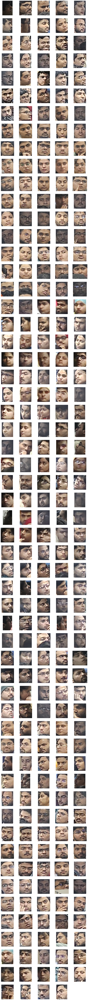

In [17]:
import math
import matplotlib.pyplot as plt

# Calculate the number of rows needed for 5 faces per row
num_rows = math.ceil(len(unique_faces) / 5)

# Set the figure size accordingly
plt.figure(figsize=[15, 3 * num_rows])

# Loop through each face and display it
for i, face in enumerate(unique_faces):
    row = i // 5  # Calculate the row index
    col = i % 5   # Calculate the column index
    plt.subplot(num_rows, 5, i + 1)  # Create the subplot
    plt.imshow(face)
    plt.axis('off')

plt.show()
